![](https://dbuscombe-usgs.github.io/MLMONDAYS/img/favicon.ico)

# ML-Mondays. Week 2: Supervised Image Object Detection


See the [course website](https://dbuscombe-usgs.github.io/MLMONDAYS/) for more information

>A) Live session: We'll work through jupyter notebooks containing workflows for image object detection (pixelwise classification). We'll be trying to answer the question, How do people use beaches?. To answer this question, we will train a deep learning model to detect and locate people in webcam (static, oblique) images of a beach in Florida. See the [data page](https://dbuscombe-usgs.github.io/MLMONDAYS/docs/doc2) for more information.


>B) Optional class assignment: participants will be encouraged to adapt what they learned in the class to their own object recognition problems using their own data. Or, catch-up; it's a short week!

## Written by Daniel Buscombe

![](https://mardascience.com/wp-content/uploads/2019/06/cropped-MardaScience_logo-5.png)

MIT License

Copyright (c) 2020, Marda Science LLC

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.

In [ ]:
!git clone --depth 1 https://github.com/dbuscombe-usgs/MLMONDAYS.git

Cloning into 'MLMONDAYS'...
remote: Enumerating objects: 488, done.
remote: Counting objects: 100% (488/488), done.
remote: Compressing objects: 100% (443/443), done.
remote: Total 488 (delta 74), reused 389 (delta 32), pack-reused 0
Receiving objects: 100% (488/488), 504.47 MiB | 26.83 MiB/s, done.
Resolving deltas: 100% (74/74), done.
Checking out files: 100% (481/481), done.


![](https://raw.githubusercontent.com/dbuscombe-usgs/MLMONDAYS/master/2_ObjRecog/notebooks/assets/objrecog_summary.png)

![](https://raw.githubusercontent.com/dbuscombe-usgs/MLMONDAYS/master/2_ObjRecog/notebooks/assets/objrecog_training.png)

![](https://raw.githubusercontent.com/dbuscombe-usgs/MLMONDAYS/master/2_ObjRecog/notebooks/assets/objrecog_prediction.png)

In [ ]:
import os
os.chdir('MLMONDAYS/2_ObjRecog')

Dowload the data set

In [ ]:
!python download_data.py

2020-09-27 19:03:16.257834: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
129703936/129701000 [==============================] - 4s 0us/step
Unzipping to ./data ... 
283189248/283188361 [==============================] - 9s 0us/step
Unzipping to ./retinanet/scratch ... 
283435008/283426999 [==============================] - 8s 0us/step
Unzipping to ./retinanet/finetune ... 


In [ ]:
!mv data/checkpoint data/coco
!mv data/final* data/coco

Check inside `MLMONDAYS\2_ObjRecog\data`: you should see two new folders `coco` and `secoora`


In this exercise, we will build and evaluate models to find and classify people in images of beaches

### Mini-lecture 1: Models overview

> Slides are [here](https://docs.google.com/presentation/d/1P1w0kbq_XFWd242nuAruUe5TLgF29kTuDVTjSzGIlNM/edit?usp=sharing)

### Mini-lecture 2: Object detection with RetinaNet

> Slides are [here](https://docs.google.com/presentation/d/1tz63hV3eWNl6HjtiB4LzTX8HGU7Z1sVckJh6XzWdvas/edit?usp=sharing)


### Preliminaries

In [ ]:
from imports import *

#----------------------------------------------
def get_inference_model(threshold, model):
    """
    get_inference_model(threshold, model)
    This function creates an inference model consisting of an input layer for an image
    the model predictions, decoded detections, then finally a mapping from image to detections
    In effect it is a model nested in another model
    INPUTS:
        * threshold [float], the detecton probability beyond which we are confident of
        * model [keras model], trained object detection model
    OPTIONAL INPUTS: None
    GLOBAL INPUTS: start_lr, min_lr, max_lr, rampup_epochs, sustain_epochs, exp_decay
    OUTPUTS:  keras model for detections on images
    """
    # ANY size input
    image = tf.keras.Input(shape=[None, None, 3], name="image")

    predictions = model(image, training=False)

    detections = DecodePredictions(confidence_threshold=threshold)(image, predictions)

    inference_model = tf.keras.Model(inputs=image, outputs=detections)
    return inference_model


def lrfn(epoch):
    """
    lrfn(epoch)
    This function creates a custom piecewise linear-exponential learning rate function
    for a custom learning rate scheduler. It is linear to a max, then exponentially decays
    INPUTS: current epoch number
    OPTIONAL INPUTS: None
    GLOBAL INPUTS: start_lr, min_lr, max_lr, rampup_epochs, sustain_epochs, exp_decay
    OUTPUTS:  the function lr with all arguments passed
    """
    def lr(epoch, start_lr, min_lr, max_lr, rampup_epochs, sustain_epochs, exp_decay):
        if epoch < rampup_epochs:
            lr = (max_lr - start_lr)/rampup_epochs * epoch + start_lr
        elif epoch < rampup_epochs + sustain_epochs:
            lr = max_lr
        else:
            lr = (max_lr - min_lr) * exp_decay**(epoch-rampup_epochs-sustain_epochs) + min_lr
        return lr
    return lr(epoch, start_lr, min_lr, max_lr, rampup_epochs, sustain_epochs, exp_decay)



Version:  2.3.0
Eager mode:  True
GPU name:  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Num GPUs Available:  1


Set variables:

* `sample_data_path`: where the sample jpegs are
* `train_hist_fig` : the file you'd like to print your model training history to
* `model_dir`: the folder that will contain your trained weights
* `weights_dir`: the folder that contains coco2017 weights, used for transfer learning 

In [ ]:
sample_data_path = 'data/sample'
train_hist_fig = os.getcwd()+os.sep+'results/secoora_retinanet_model1.png'

model_dir = "retinanet/"
weights_dir = "data/coco"

### Data viz.

We are going to take a look at a sample of images and their manually labeled (by me, Dan Buscombe!) bounding boxes

The bounding box info is contained in the file `sample_csv`

In [ ]:
sample_csv = 'data/sample.csv'

sample_filenames = sorted(tf.io.gfile.glob(sample_data_path+os.sep+'*.jpg'))
print(len(sample_filenames))

dat = pd.read_csv(sample_csv)
print(len(dat))

20
316


Each image has variable numbers of bounding boxes, from zero to several tens. The function `split` (inside `tfrecords_funcs.py`) will split a pandas dataframe into groups, based on the column 'filename'. Each group refers to an individual image and the objects therein, so we can plot this collection  

In [ ]:
grouped = split(dat, 'filename')

For each group, read the image using `file2tensor` (defined in `tfrecords_funcs.py`), and plot the image and bounding boxes using matplotlib's `Rectangle` function 

We'll also keep track of how many people in each image, which will be our 'real world' success metric

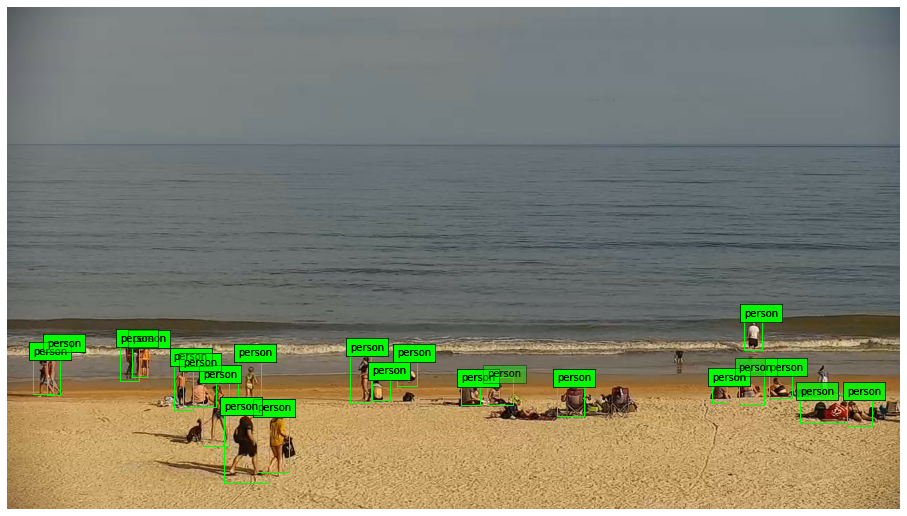

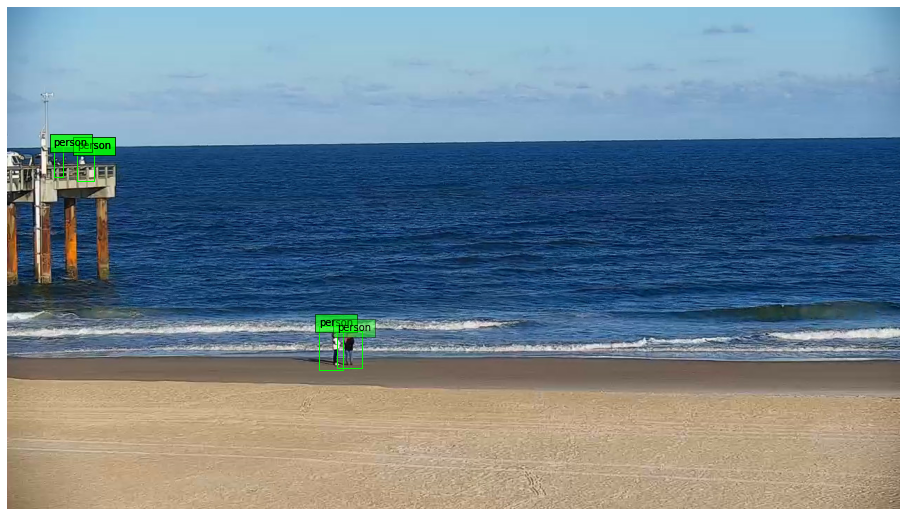

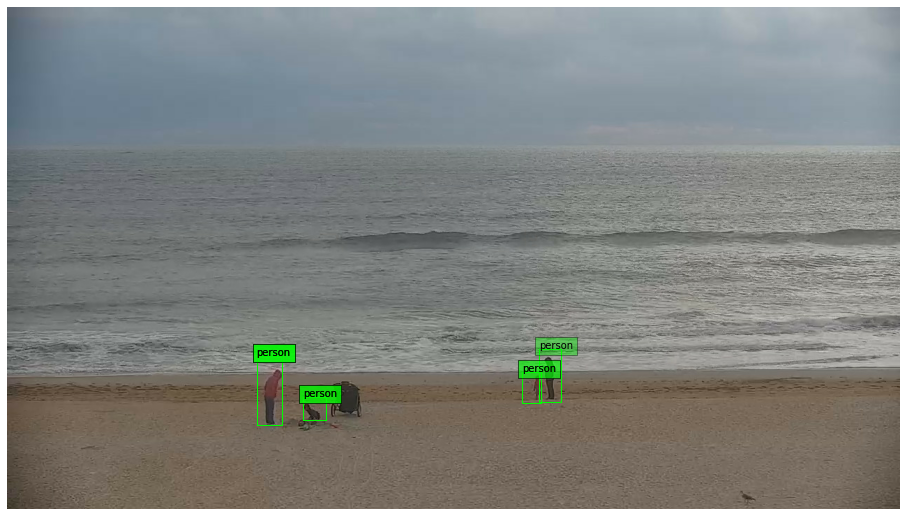

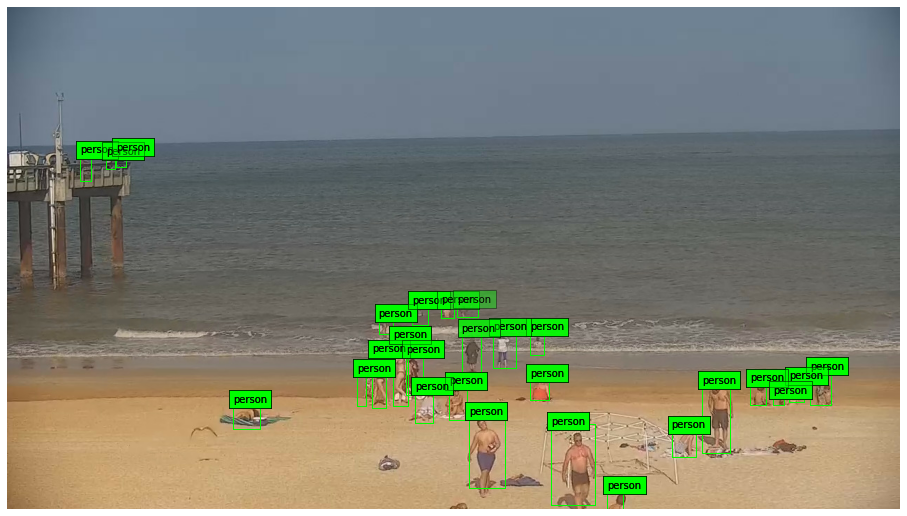

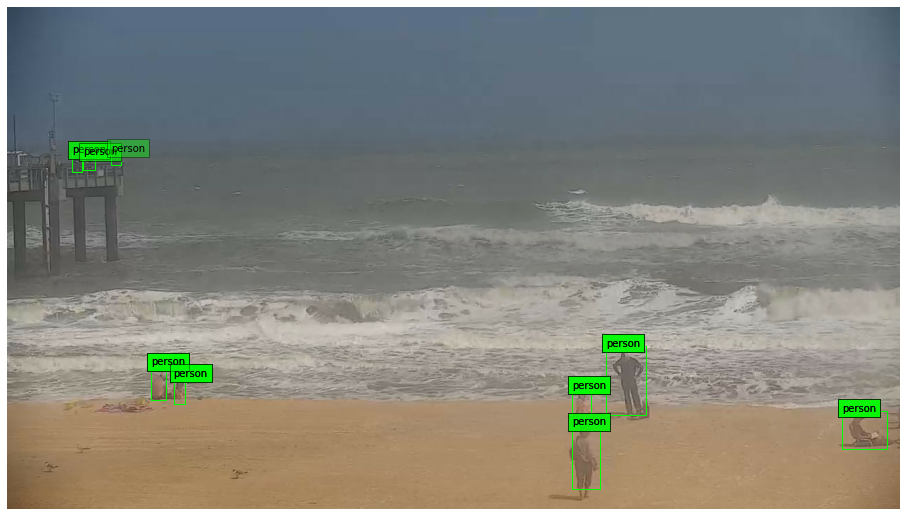

...

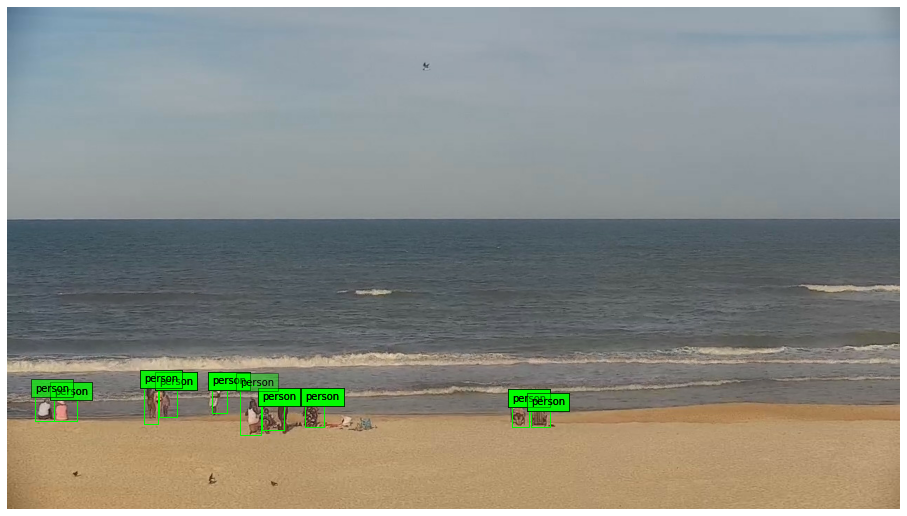

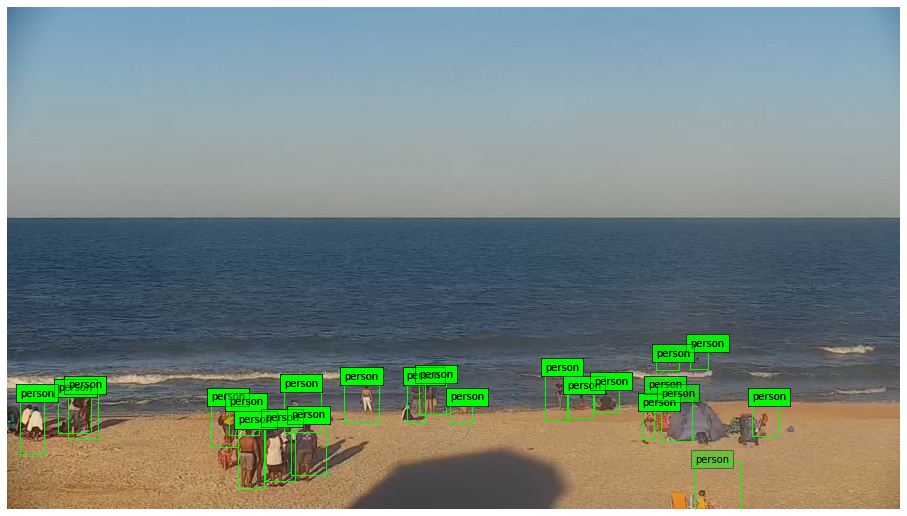

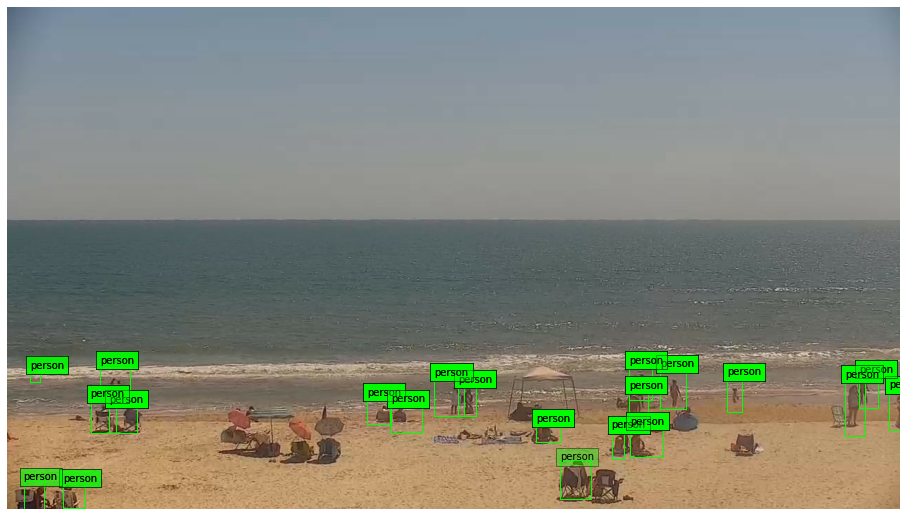

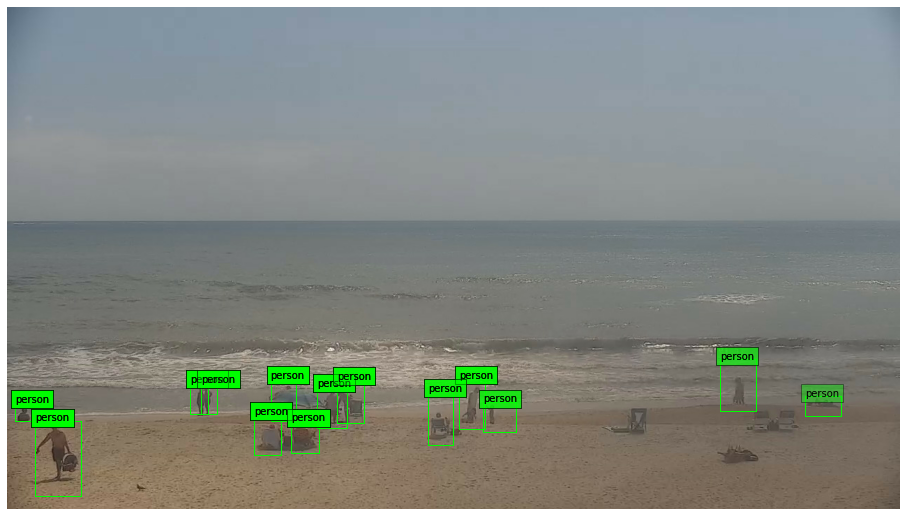

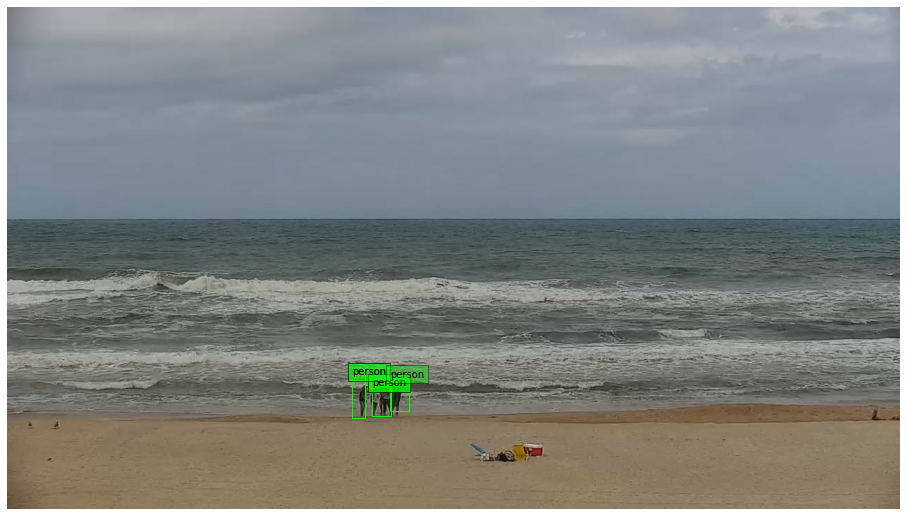

In [ ]:
SAMPLE_NUM_PEOPLE=[]
counter = 0
for group in grouped:
    image = file2tensor('data/sample/'+group[0])

    fig =plt.figure(figsize=(16,16))
    plt.axis("off")
    plt.imshow(image)
    ax = plt.gca()

    bboxs = []
    labels = []
    for index, row in group.object.iterrows():
        labels.append(class_text_to_int(row['class']))
        bboxs.append([row['xmin'], row['ymin'], row['xmax'], row['ymax']])
        for box in bboxs:
            x1, y1, x2, y2 = box
            w, h = x2 - x1, y2 - y1
            patch = plt.Rectangle([x1, y1], w, h, fill=False, edgecolor=[0, 1, 0], linewidth=1)
            ax.add_patch(patch)
            ax.text(x1, y1, 'person', bbox={"facecolor": [0, 1, 0], "alpha": 0.4}, clip_box=ax.clipbox, clip_on=True)
    plt.show()
    SAMPLE_NUM_PEOPLE.append(len(bboxs))
    # plt.savefig('examples/secoora_examples'+str(counter)+'.png', dpi=200, bbox_inches='tight')
    # counter += 1

### The Plan

#### RetinaNet
We are going to build a model called RetinaNet, to detect people in images of often-crowded beaches. RetinaNet is a popular single-stage object detector, which is accurate and runs fast. It uses a feature pyramid network to efficiently detect objects at multiple scales and uses a new Focal loss function, to alleviate the problem of the extreme foreground-background class imbalance.

* [Retina paper](https://arxiv.org/abs/1708.02002)
* [Feature pyramid paper](https://arxiv.org/abs/1612.03144)

#### Fine-tune with COCO2017 subset
First, we'll initialize the model with COCO2017 weights for a model trained on the COCO2017 [data set](https://cocodataset.org/#overview) consisting of around 118k images. The 80 classes include 'person', which is also what we have labeled the SECOORA imagery. The other 79 classes include various types of vehicles, animals, sports, kitchen items, food items, personal accessories, furniture, etc. In other words, objects generally at close scale. In the imagery of beaches, or in imagery of natural environments, the objects of interest may not be so close-up. So, one of the attractive features of RetinaNet is the image pyramiding that detects object at 5 different scales. This implementation is based heavily on code [here](https://keras.io/examples/vision/retinanet/). When we ran `download_data.py` earlier on, we downloaded the weights and a subset of the COCO imagery [here](https://github.com/srihari-humbarwadi/datasets/releases)

Next, we'll fine-tune it on the SECOORA imagery, to illustrate the process of fine-tuning a model on similar dataset. We'll adopt a similar workflow to that in Part 1, where we used a learning rate scheduler, early stopping, and model checkpoints

#### Used the model to predict unseen imagery
Then, I'll demonstrate the process of how you would use the trained/fined tuned model on sample imagery (jpeg images in a local folder)

#### Train a model from scratch
Next we'll show how to train a model from scratch - this takes too much time, so we'll download the weights from this exercise, load them into the model, and finally use for prediction

In the end, we'll see our model trained from scratch is an excellent way to count people on beaches



### Initializing the model

RetinaNet uses a ResNet based backbone, using which a feature pyramid network is constructed. In the example we use ResNet50 as the backbone, and return the
feature maps at strides 8, 16 and 32.

In [ ]:
resnet50_backbone = get_backbone()

94773248/94765736 [==============================] - 1s 0us/step


The overall loss of the model is the sum of two losses, the Smooth L1 loss and Focal Loss. Because of the custom combination, they are define as keras custom losses

In [ ]:
num_classes = 80

In [ ]:
loss_fn = RetinaNetLoss(num_classes)

Building the classification and box regression heads.

The RetinaNet model has separate heads for bounding box regression and for predicting class probabilities for the objects. These heads are shared between all the feature maps of the feature pyramid.

In [ ]:
model = RetinaNet(num_classes, resnet50_backbone)

Custom learning rate scheduler

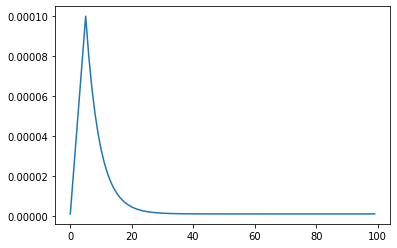

In [ ]:
lr_callback = tf.keras.callbacks.LearningRateScheduler(lambda epoch: lrfn(epoch), verbose=True)

rng = [i for i in range(MAX_EPOCHS)]
y = [lrfn(x) for x in rng]
plt.plot(rng, [lrfn(x) for x in rng])
# plt.show()
# plt.savefig(os.getcwd()+os.sep+'results/learnratesched.png', dpi=200, bbox_inches='tight')


In [ ]:

earlystop = EarlyStopping(monitor="val_loss",
                              mode="min", patience=patience)


model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
        filepath=os.path.join(model_dir, "weights" + "_epoch_{epoch}"),
        monitor="val_loss",
        save_best_only=True,
        save_weights_only=True,
        verbose=1,
    )

callbacks = [model_checkpoint, earlystop, lr_callback]

optimizer = tf.optimizers.SGD(momentum=0.9)
model.compile(loss=loss_fn, optimizer=optimizer)

In [ ]:
weights_dir

'data/coco'

Load the COCO2017 model checkpoint, that contains the model weights

In [ ]:
latest_checkpoint = tf.train.latest_checkpoint(weights_dir)
model.load_weights(latest_checkpoint)

Build the inference model

`threshold` is the probability threshold above which to show the detection. For example, if threshold is 0.5, only detections with probabilities aobe this value will be shown

We use a slightly lower threshold, 0.33

In [ ]:
threshold = 0.33 #0.5

inference_model = get_inference_model(threshold, model)

### Prediction using COCO weights (demonstration)

Load the COCO2017 dataset using TensorFlow Datasets


In [ ]:
# 'analysis ready'
val_dataset, dataset_info = tfds.load("coco/2017", split="validation", data_dir="data",
                        with_info=True)

int2str = dataset_info.features["objects"]["label"].int2str

In [ ]:
figsize = (10,10)
linewidth = 1
color = [0,1,0]

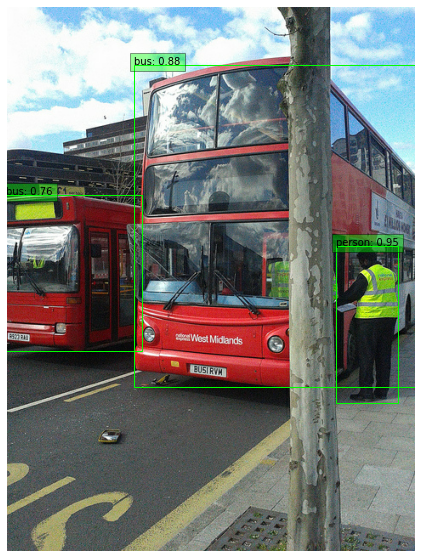

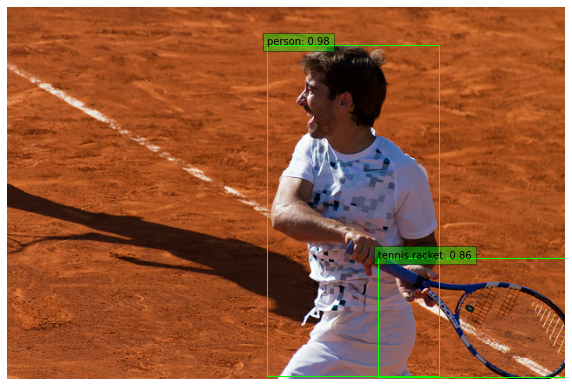

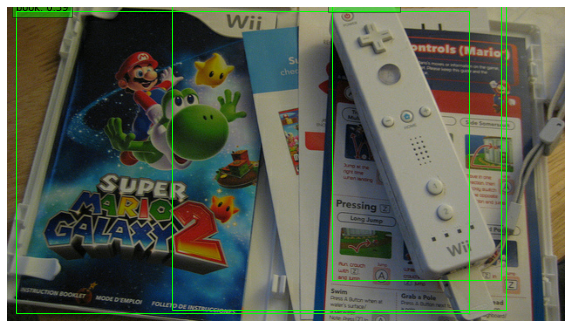

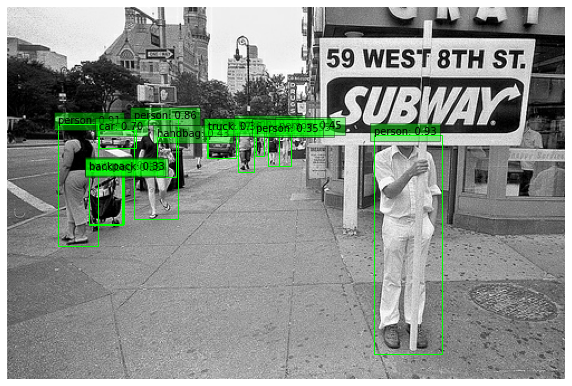

In [ ]:
counter = 0
for sample in val_dataset.take(4):
    image = tf.cast(sample["image"], dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    num_detections = detections.valid_detections[0]
    class_names = [
        int2str(int(x)) for x in detections.nmsed_classes[0][:num_detections]
    ]
    boxes = detections.nmsed_boxes[0][:num_detections] / ratio
    scores = detections.nmsed_scores[0][:num_detections]

    image = np.array(image, dtype=np.uint8)
    fig =plt.figure(figsize=figsize)
    plt.axis("off")
    plt.imshow(image)
    ax = plt.gca()
    for box, _cls, score in zip(boxes, class_names, scores):
        text = "{}: {:.2f}".format(_cls, score)
        x1, y1, x2, y2 = box
        w, h = x2 - x1, y2 - y1
        patch = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color, linewidth=linewidth
        )
        ax.add_patch(patch)
        ax.text(
            x1,
            y1,
            text,
            bbox={"facecolor": color, "alpha": 0.4},
            clip_box=ax.clipbox,
            clip_on=True,
        )
    plt.show()
    # visualize_detections(image, boxes, class_names, scores, counter, 'examples/coco_obrecog_part1_examples')
    # counter +=1

### Prediction on SECOORA imagery

How good is the model at finding people on beaches 'straight out of the box'?

In [ ]:
sample_filenames = sorted(tf.io.gfile.glob(sample_data_path+os.sep+'*.jpg'))

print(len(sample_filenames))

20


Let's change some things - first we'll use blue boxes

And we'll lower the probability threshold

In [ ]:
color = [0,0,1]

inference_model = get_inference_model(0.25, model)

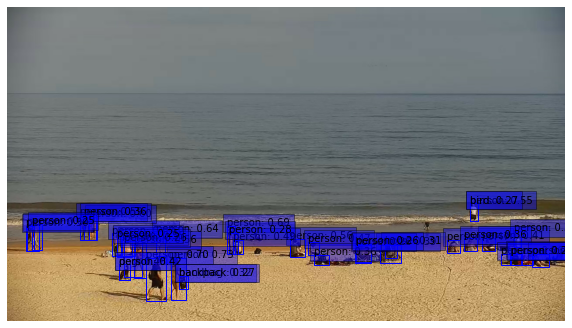

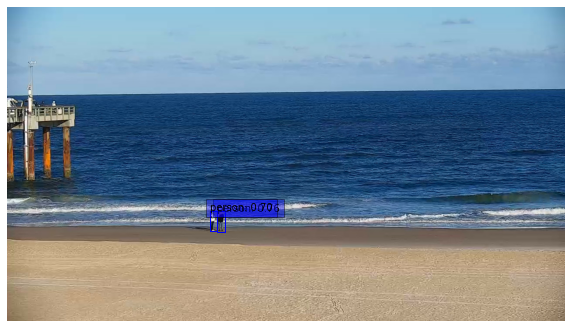

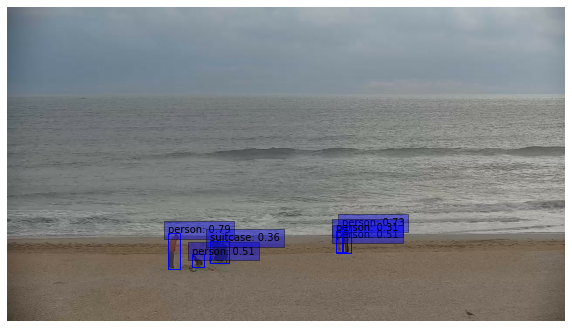

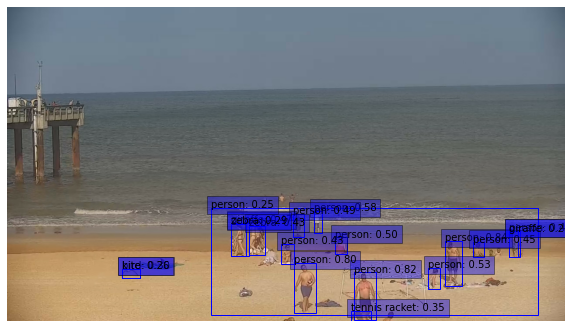

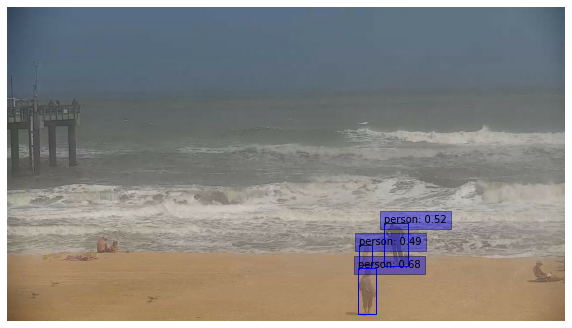

...

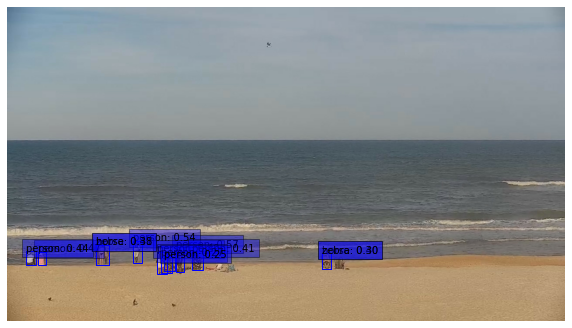

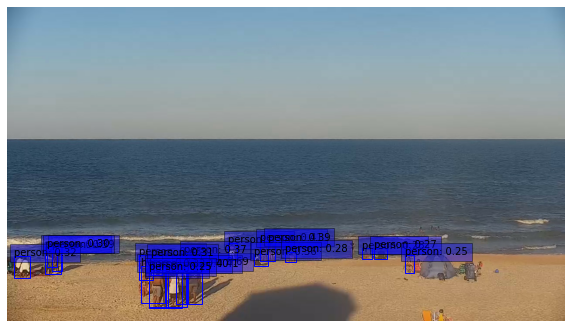

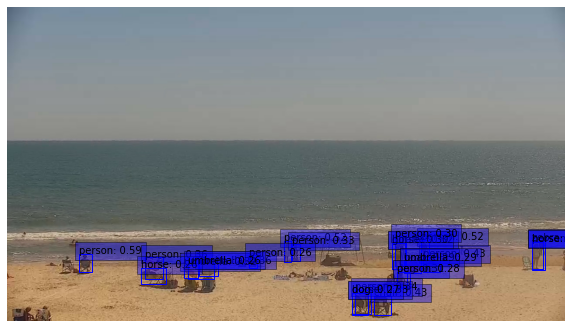

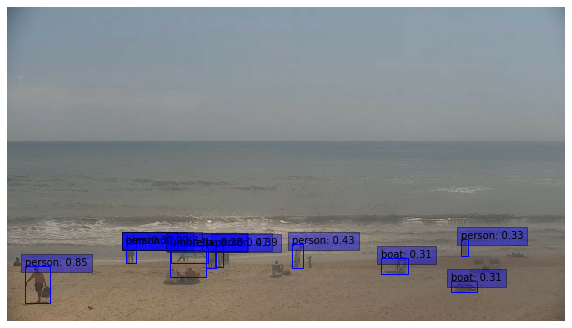

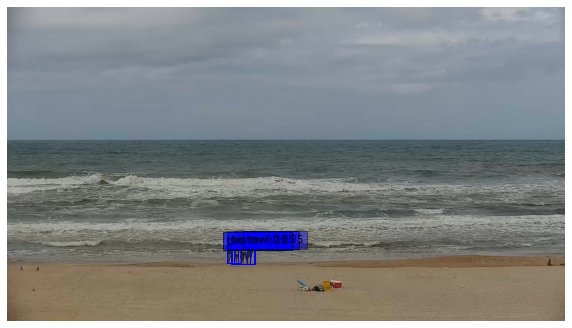

In [ ]:
# whats sorts of things might be we interested in?
SCORES =[] #probability of detection
NUM_PEOPLE = [] #number of people

for counter,f in enumerate(sample_filenames):
    image = file2tensor(f)

    image = tf.cast(image, dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    num_detections = detections.valid_detections[0]

    boxes = detections.nmsed_boxes[0][:num_detections] / ratio
    scores = detections.nmsed_scores[0][:num_detections]

    classes = ['person' for k in boxes]
    class_names = [
        int2str(int(x)) for x in detections.nmsed_classes[0][:num_detections]
    ]

    image = np.array(image, dtype=np.uint8)
    fig =plt.figure(figsize=figsize)
    plt.axis("off")
    plt.imshow(image)
    ax = plt.gca()
    for box, _cls, score in zip(boxes, class_names, scores):
        text = "{}: {:.2f}".format(_cls, score)
        x1, y1, x2, y2 = box
        w, h = x2 - x1, y2 - y1
        patch = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color, linewidth=linewidth
        )
        ax.add_patch(patch)
        ax.text(
            x1,
            y1,
            text,
            bbox={"facecolor": color, "alpha": 0.4},
            clip_box=ax.clipbox,
            clip_on=True,
        )
    plt.show()


    # visualize_detections(image, boxes, classes,scores, counter, 'examples/secoora_cocoweights_obrecog_part1_examples', figsize=(16, 16), linewidth=1, color=[0, 1, 0])
    SCORES.append(scores)
    NUM_PEOPLE.append(len(scores))

SCORES = np.hstack(SCORES)

### Train on more data

The model has already been trained on the full coco dataset. Next you could train the model further on a COCO-like dataset with the same number of classes (80). You could load the local version of the COCO2017 dataset using TensorFlow Datasets and fine-tune the model that way

In [ ]:
# (train_dataset, val_dataset), dataset_info = tfds.load(
#     "coco/2017", split=["train", "validation"], with_info=True, data_dir="data"
# )

Instead we'll fine-tune on our data

In [ ]:
data_path= os.getcwd()+os.sep+"data/secoora"

val_filenames = sorted(tf.io.gfile.glob(data_path+os.sep+'*val*.tfrecord'))
train_filenames = sorted(tf.io.gfile.glob(data_path+os.sep+'*train*.tfrecord'))

### Preprocessing data
Preprocessing the images involves two steps:

* Resizing the image: Images are resized such that the shortest size is equal
to 800 px, after resizing if the longest side of the image exceeds 1333 px,
the image is resized such that the longest size is now capped at 1333 px.

* Applying augmentation: Random scale jittering  and random horizontal flipping
are the only augmentations applied to the images.

Along with the images, bounding boxes are rescaled and flipped if required.



In [ ]:
# train_dataset, val_dataset = prepare_coco_datasets_for_training(train_dataset, val_dataset)

In [ ]:
train_dataset, val_dataset = prepare_secoora_datasets_for_training(data_path, train_filenames, val_filenames)

### Setting up a `tf.data` pipeline
To ensure that the model is fed with data efficiently we will be using
`tf.data` API to create our input pipeline. The input pipeline
consists for the following major processing steps:
* Apply the preprocessing function to the samples
* Create batches with fixed batch size. Since images in the batch can
have different dimensions, and can also have different number of
objects, we use `padded_batch` to the add the necessary padding to create
rectangular tensors
* Create targets for each sample in the batch using `LabelEncoderCoco`



### Train the model 

This demonstrates how you can use the `.take()` feature of TF datasets to control the amount of imagery to use

In [ ]:
history = model.fit(
    train_dataset.take(50),
    validation_data=val_dataset.take(50),
    epochs=10,
    callbacks=callbacks,
    verbose=1,
)

K.clear_session()


Epoch 00001: LearningRateScheduler reducing learning rate to 1e-06.
Epoch 1/10
     50/Unknown - 24s 472ms/step - loss: 0.9993
Epoch 00001: val_loss improved from inf to 0.88467, saving model to retinanet/weights_epoch_1
50/50 [==============================] - 38s 769ms/step - loss: 0.9993 - val_loss: 0.8847

Epoch 00002: LearningRateScheduler reducing learning rate to 2.08e-05.
Epoch 2/10
50/50 [==============================] - ETA: 0s - loss: 0.9993
Epoch 00002: val_loss did not improve from 0.88467
50/50 [==============================] - 24s 473ms/step - loss: 0.9993 - val_loss: 0.9043

Epoch 00003: LearningRateScheduler reducing learning rate to 4.06e-05.
Epoch 3/10
50/50 [==============================] - ETA: 0s - loss: 0.8844
Epoch 00003: val_loss did not improve from 0.88467
50/50 [==============================] - 23s 458ms/step - loss: 0.8844 - val_loss: 0.9356

Epoch 00004: LearningRateScheduler reducing learning rate to 6.04e-05.
Epoch 4/10
50/50 [======================

### Mini-lecture 2: Know thy data

> Slides are [here](https://docs.google.com/presentation/d/1Om8bFJPI4kC7QmIoFXVozI3lTeF0s-YKBylkfdvuYT4/edit?usp=sharing)

### Model evaluation

Let's first take a look at the model's training and validation loss curves

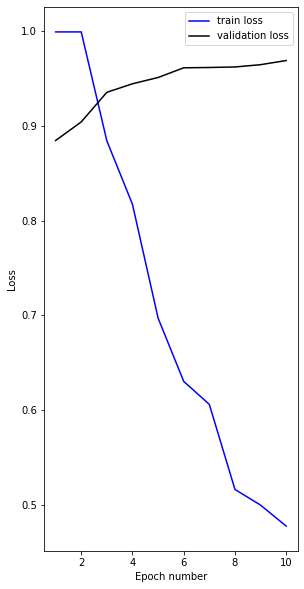

In [ ]:
n = len(history.history['loss'])

plt.figure(figsize=(10,10))
plt.subplot(121)
plt.plot(np.arange(1,n+1), history.history['loss'], 'b', label='train loss')
plt.plot(np.arange(1,n+1), history.history['val_loss'], 'k', label='validation loss')
plt.xlabel('Epoch number', fontsize=10); plt.ylabel('Loss', fontsize=10)
plt.legend(fontsize=10)

For prediction, load the best weights from training

In [ ]:
# latest_checkpoint = tf.train.latest_checkpoint(model_dir)
# model.load_weights(latest_checkpoint)

Or load the weights from file! These have been trained like the above process but for longer and using all the data. See the workflow in the following script:

In [ ]:
## !python secoora_objrecog_part1.py

In [ ]:
finetune_weights_dir = "retinanet/finetune"

latest_checkpoint = tf.train.latest_checkpoint(finetune_weights_dir)
print(latest_checkpoint)
model.load_weights(latest_checkpoint)

Set a prediction threshold and make an inference model

In [ ]:
threshold = 0.4

inference_model = get_inference_model(threshold, model)

For each sample image, load it in to memory and prepare it as a model input, then use the model to find the objects

Parse the detections, their bounding boxes and classes, and plot them

Keep track of model scores, and number of people detected

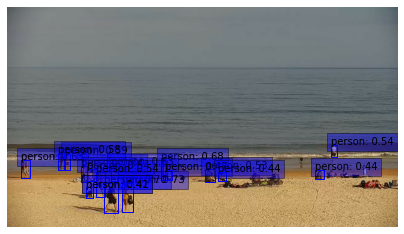

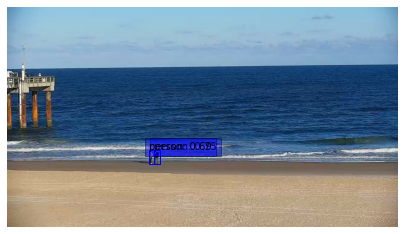

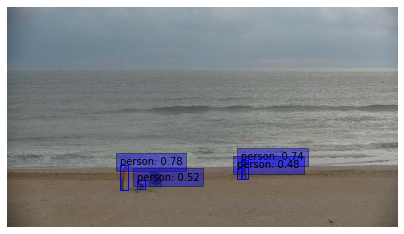

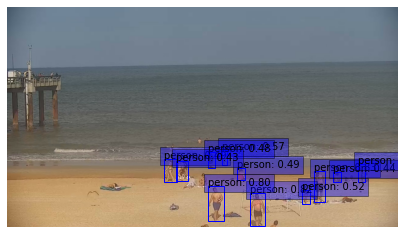

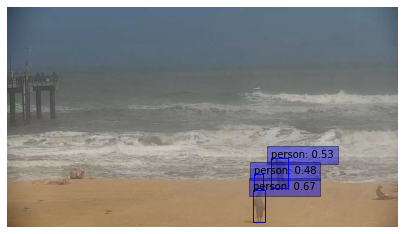

...

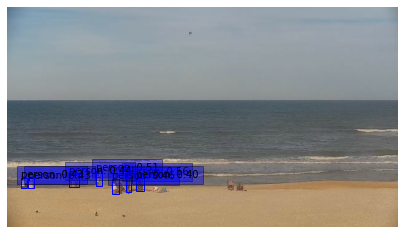

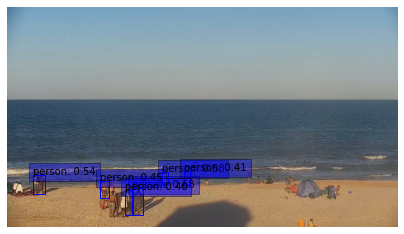

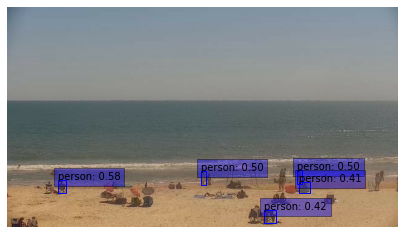

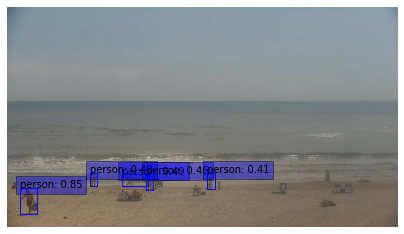

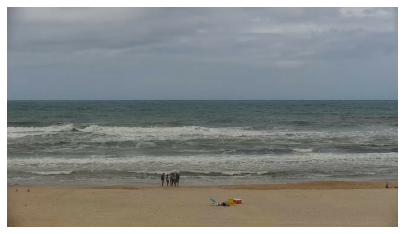

In [ ]:
figsize=(12, 12)
linewidth=1
color=[0, 0, 1]

SCORES =[] #probability of detection
EST_NUM_PEOPLE = [] #number of people

for counter,f in enumerate(sample_filenames):
    image = file2tensor(f)

    image = tf.cast(image, dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    num_detections = detections.valid_detections[0]

    boxes = detections.nmsed_boxes[0][:num_detections] / ratio
    scores = detections.nmsed_scores[0][:num_detections]

    classes = ['person' for k in boxes]

    # visualize_detections(image, boxes, classes,scores, counter, 'examples/secoora_finetunedweights_obrecog_part1_examples', figsize=(16, 16), linewidth=1, color=[0, 1, 0])
    SCORES.append(scores)
    EST_NUM_PEOPLE.append(len(scores))

    image = np.array(image, dtype=np.uint8)
    fig =plt.figure(figsize=figsize)
    plt.axis("off")
    plt.imshow(image)
    ax = plt.gca()
    for box, _cls, score in zip(boxes, classes, scores):
        text = "{}: {:.2f}".format(_cls, score)
        x1, y1, x2, y2 = box
        w, h = x2 - x1, y2 - y1
        patch = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color, linewidth=linewidth
        )
        ax.add_patch(patch)
        ax.text(
            x1,
            y1,
            text,
            bbox={"facecolor": color, "alpha": 0.4},
            clip_box=ax.clipbox,
            clip_on=True,
        )


SCORES = np.hstack(SCORES)


Good!

Text(0, 0.5, 'Estimated number of people per frame')

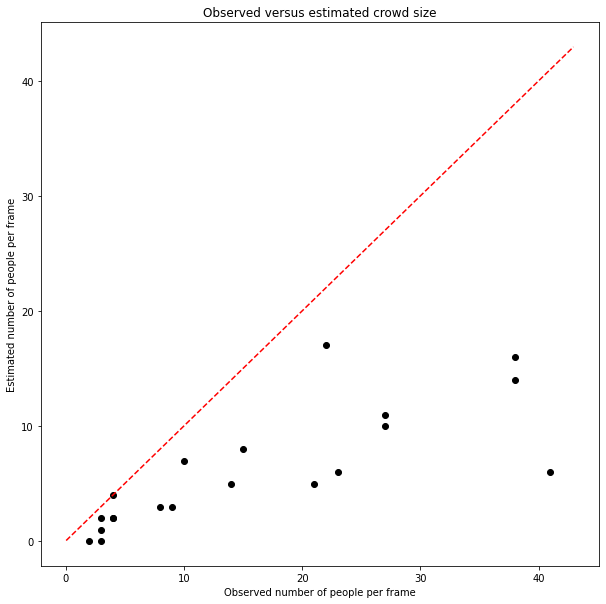

In [ ]:
plt.figure(figsize=(10,10))
plt.plot(SAMPLE_NUM_PEOPLE, EST_NUM_PEOPLE, 'ko')
xlim=plt.xlim()
plt.plot(xlim, xlim, 'r--')
plt.title('Observed versus estimated crowd size')
plt.xlabel('Observed number of people per frame')
plt.ylabel('Estimated number of people per frame')

You could set the threshold lower to include more people, but then run into the danger of incorporating more things that aren't people, or counting people twice. Therefore the threshold becomes a calibration parameter of sorts

### Train a model from scratch

Can we do better? Perhaps the model doesn't need weights from another dataset. We have another option: training the model; from scratch, by initializing the network with random numbers for weights, then training the model end-to-end on the secoora dataset

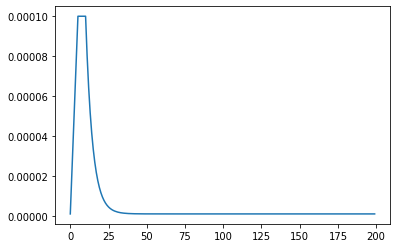

In [ ]:
start_lr = 1e-06
min_lr = start_lr
max_lr = 1e-04
rampup_epochs = 5
sustain_epochs = 5
exp_decay = .8
MAX_EPOCHS = 200
patience = 10

lr_callback = tf.keras.callbacks.LearningRateScheduler(lambda epoch: lrfn(epoch), verbose=True)


rng = [i for i in range(MAX_EPOCHS)]
y = [lrfn(x) for x in rng]
plt.plot(rng, [lrfn(x) for x in rng])
# plt.show()

In [ ]:
resnet50_backbone = get_backbone()
loss_fn = RetinaNetLoss(num_classes)
model2 = RetinaNet(num_classes, resnet50_backbone)

In [ ]:
earlystop = EarlyStopping(monitor="val_loss",
                              mode="min", patience=patience)


# chaneg fileprefix for the trained from scratch weights
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
        filepath=os.path.join(model_dir, "scratch_weights" + "_epoch_{epoch}"),
        monitor="val_loss",
        save_best_only=True,
        save_weights_only=True,
        verbose=1,
    )


optimizer = tf.optimizers.SGD(momentum=0.9)
# optimizer = tf.optimizers.SGD(learning_rate=learning_rate_fn, momentum=0.9)
model2.compile(loss=loss_fn, optimizer=optimizer)

# no loading of weights - training from scratch
callbacks = [model_checkpoint, earlystop, lr_callback]


Get a list of the training and validation tfrecords. We only have one each (we have a relatively small dataset for a big deep learning model like this)

Prepare a validation and train set for model training using `prepare_secoora_datasets_for_training` (in `tfrecords_funcs.py`). I've switched the sets below so what is named the training set, which has fewer examples, is actually used for validation

In [ ]:
data_path= os.getcwd()+os.sep+"data"

val_filenames = sorted(tf.io.gfile.glob(data_path+os.sep+'*val*.tfrecord'))
train_filenames = sorted(tf.io.gfile.glob(data_path+os.sep+'*train*.tfrecord'))

# swap the train and val sets because the val set is much larger
val_dataset, train_dataset = prepare_secoora_datasets_for_training(data_path, train_filenames, val_filenames)

Fit the model to the data, from scratch, without any pre-loaded weights from another dataset. This means the model has to relearn all network weights

This takes a long time, so it is commented. We'll load the weights that were the results of this process for inference

In [ ]:
# history = model.fit(
#     train_dataset, validation_data=val_dataset, epochs=MAX_EPOCHS, callbacks=callbacks)

In [ ]:
K.clear_session()

### Trained-from-scratch model evaluation

Let's first take a look at the model's training and validation loss curves

Uncomment the cells below if you trained (uncommented and ran the `model.fit` cell above)

In [ ]:
# n = len(history.history['loss'])

# plt.figure(figsize=(10,10))
# plt.subplot(121)
# plt.plot(np.arange(1,n+1), history.history['loss'], 'b', label='train loss')
# plt.plot(np.arange(1,n+1), history.history['val_loss'], 'k', label='validation loss')
# plt.xlabel('Epoch number', fontsize=10); plt.ylabel('Loss', fontsize=10)
# plt.legend(fontsize=10)

In [ ]:
# latest_checkpoint = tf.train.latest_checkpoint(model_dir)
# print(latest_checkpoint)
# model.load_weights(latest_checkpoint)

Load the weights that were previously obtained training this model in the above way

In [ ]:
scratch_weights_dir = "retinanet/scratch"

In [ ]:
latest_checkpoint = tf.train.latest_checkpoint(scratch_weights_dir)
print(latest_checkpoint)
model.load_weights(latest_checkpoint)

retinanet/scratch/scratch_weights_epoch_12


Use the same threshold as before, for a fair comparison of the effects of training from scratch

In [ ]:
print(threshold)

inference_model = get_inference_model(threshold, model)

0.4


Use the new model trained from scratch to find people, keeping scores again and tallying the number of people per image

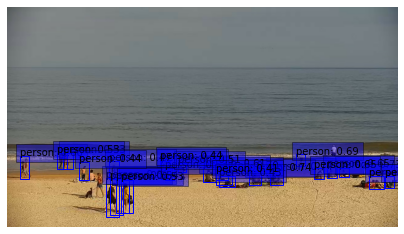

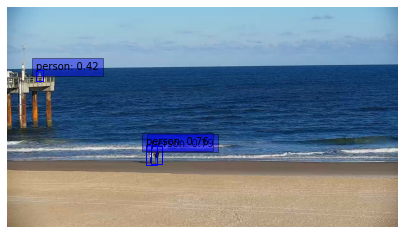

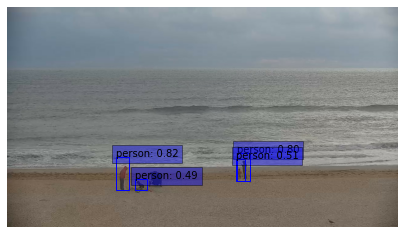

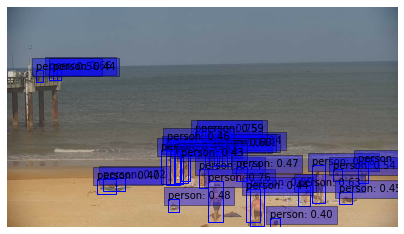

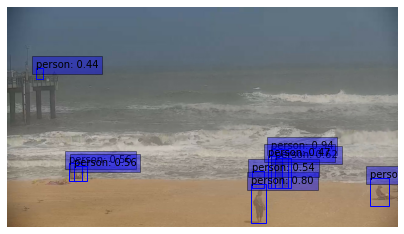

...

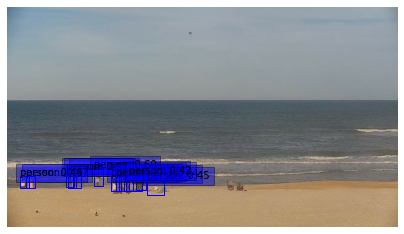

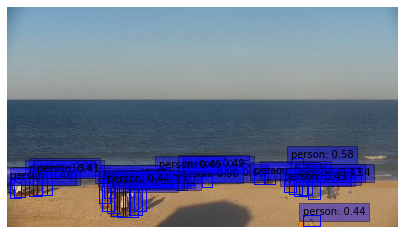

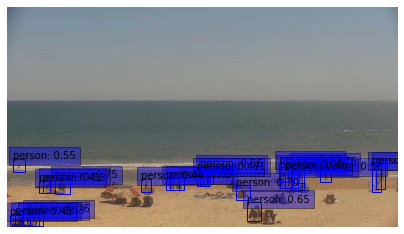

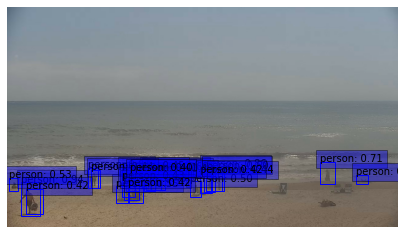

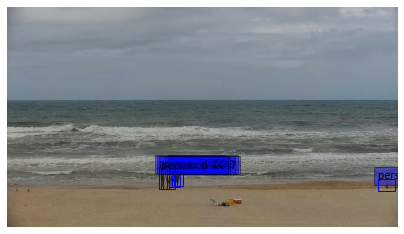

In [ ]:
figsize=(7, 7)
linewidth=1
color=[0, 0, 1]

SCORES2 =[] #probability of detection
EST_NUM_PEOPLE2 = [] #number of people

for counter,f in enumerate(sample_filenames):
    image = file2tensor(f)

    image = tf.cast(image, dtype=tf.float32)
    input_image, ratio = prepare_image(image)
    detections = inference_model.predict(input_image)
    num_detections = detections.valid_detections[0]

    boxes = detections.nmsed_boxes[0][:num_detections] / ratio
    scores = detections.nmsed_scores[0][:num_detections]

    classes = ['person' for k in boxes]

    # visualize_detections(image, boxes, classes,scores, counter, 'examples/secoora_finetunedweights_obrecog_part1_examples', figsize=(16, 16), linewidth=1, color=[0, 1, 0])
    SCORES2.append(scores)
    EST_NUM_PEOPLE2.append(len(scores))

    image = np.array(image, dtype=np.uint8)
    fig =plt.figure(figsize=figsize)
    plt.axis("off")
    plt.imshow(image)
    ax = plt.gca()
    for box, _cls, score in zip(boxes, classes, scores):
        text = "{}: {:.2f}".format(_cls, score)
        x1, y1, x2, y2 = box
        w, h = x2 - x1, y2 - y1
        patch = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color, linewidth=linewidth
        )
        ax.add_patch(patch)
        ax.text(
            x1,
            y1,
            text,
            bbox={"facecolor": color, "alpha": 0.4},
            clip_box=ax.clipbox,
            clip_on=True,
        )


SCORES2 = np.hstack(SCORES2)


Finally, let's take a look at how the trained from scratch model fares against the one fine-tuned on secoora

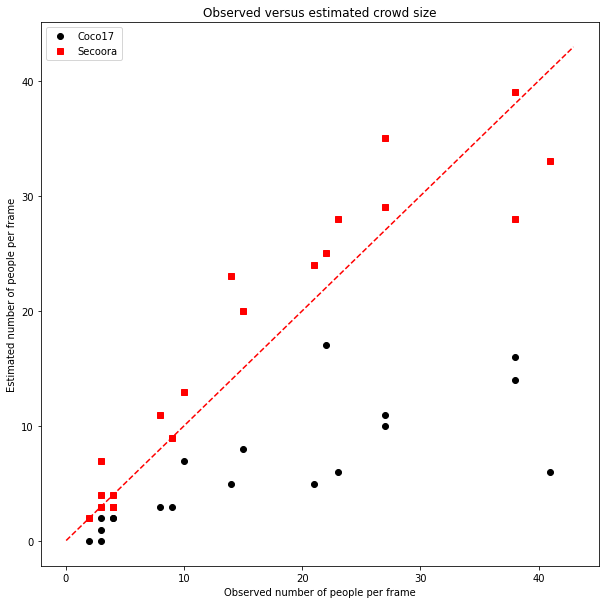

In [ ]:
plt.figure(figsize=(10,10))
r = np.min(np.corrcoef(SAMPLE_NUM_PEOPLE, EST_NUM_PEOPLE))**2
plt.plot(SAMPLE_NUM_PEOPLE, EST_NUM_PEOPLE, 'ko', label='Coco17 r^2 = '+str(r)[:4])
r = np.min(np.corrcoef(SAMPLE_NUM_PEOPLE, EST_NUM_PEOPLE2))**2
plt.plot(SAMPLE_NUM_PEOPLE, EST_NUM_PEOPLE2, 'rs', label='Secoora r^2 = '+str(r)[:4])
xlim=plt.xlim()
plt.plot(xlim, xlim, 'r--')
plt.title('Observed versus estimated crowd size')
plt.xlabel('Observed number of people per frame')
plt.ylabel('Estimated number of people per frame')
plt.legend()